In [1]:
import numpy as np 
import pandas as pd 

import funciones as f

from plotly.offline import init_notebook_mode, iplot, plot
import plotly as py
init_notebook_mode(connected=True)

import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

# word cloud library
from wordcloud import WordCloud

import matplotlib.pyplot as plt
import seaborn as sns

import warnings
warnings.filterwarnings("ignore")

### Evolución de la vivienda en España en los últimos diez años

La preocupación por la vivienda se ha disparado en los últimos meses, colándose entre los principales problemas de España, según los encuestados del último barómetro del CIS.
Según los estudios que hace el Centro de Investigaciones Sociológicas (CIS) sobre los problemas que más preocupan a los españoles, la vivienda ha ido cogiendo peso desde el pasado diciembre y en el último barómetro, los españoles la colocaban en el quinto puesto del ranking de los principales problemas de España.

In [2]:
preocupacion_viv = pd.read_csv("./data/evolucion_de_la_preocupacion_por_la_vivienda,_segun_el_cis.csv", sep=';')
preocupacion_viv.rename(columns={'% de españoles que sitúa la vivienda entre los principales problemas de España' : '% preocupación vivienda'}, inplace=True)
preocupacion_viv['Periodo'] = preocupacion_viv['Año'] + ' ' + preocupacion_viv['Periodo']
preocupacion_viv.drop(columns=['Año'], inplace=True)
preocupacion_viv['% preocupación vivienda'] = preocupacion_viv['% preocupación vivienda'].str.replace(',','.').astype(float)
preocupacion_viv.head()

,Periodo,% preocupación vivienda
0,1985 Mayo,2.1
1,1985 Octubre,2.2
2,1986 Septiembre,3.2
3,1986 Diciembre,1.9
4,1988 Junio,1.7


In [3]:
trace1 = go.Scatter(
                    x = preocupacion_viv['Periodo'],
                    y = preocupacion_viv['% preocupación vivienda'],
                    name = 'preocupacion por la vivienda',
                    mode= 'lines',
                    marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                    text = '% preocupacion')


data = [trace1]

layout = dict(title = 'Evolución de la preocupación por la vivienda en España',
             xaxis= dict(title= 'Evolución por meses',ticklen= 5)
           )

fig = go.Figure(data = data, layout=layout)

iplot(fig)

### Hipótesis1
Bajos salarios y subida de los alquileres impiden la emancipación de los jóvenes

In [4]:
injuve_diez_años = f.injuve_diez_años('2014.1T EPA','2014.2T EPA','2014.3T EPA','2014.4T EPA','2015.1T EPA','2015.2T EPA','2015.3T EPA','2015.4T EPA',
                                      '2016.1T EPA','2016.2T EPA','2016.3T EPA','2016.4T EPA','2017.1T EPA','2017.2T EPA','2017.3T EPA','2017.4T EPA',
                                      '2018.1T EPA','2018.2T EPA','2018.3T EPA','2018.4T EPA','2019.1T EPA','2019.2T EPA','2019.3T EPA','2019.4T EPA',
                                      '2020.1T EPA','2020.2T EPA','2020.3T EPA','2020.4T EPA','2021.1T EPA','2021.2T EPA','2021.3T EPA','2021.4T EPA',
                                      '2022.1T EPA','2022.2T EPA','2022.3T EPA','2022.4T EPA','2023.1T EPA','2023.2T EPA','2023.3T EPA','2023.4T EPA')

In [5]:
injuve_diez_años

,1º trim 2014,2º trim 2014,3º trim 2014,4º trim 2014,1º trim 2015,2º trim 2015,3º trim 2015,4º trim 2015,1º trim 2016,2º trim 2016,...,3º trim 2021,4º trim 2021,1º trim 2022,2º trim 2022,3º trim 2022,4º trim 2022,1º trim 2023,2º trim 2024,3º trim 2023,4º trim 2023
JÓVENES DE 16 A 29 AÑOS EN LA EPA,,,,,,,,,,,,,,,,,,,,,
Tasa de jóvenes (%) s/Tot16y+años,17.58,17.47,17.37,17.30,17.23,17.17,17.11,17.02,16.97,16.93,...,17.22,17.22,17.26,17.31,17.40,17.49,17.54,17.55,17.65,17.78
Tasa de Emancipación (%),23.78,23.88,23.36,23.07,22.98,22.36,22.02,22.10,22.05,21.33,...,15.91,17.18,17.14,17.91,17.24,17.79,18.13,18.31,18.21,18.73
Tasa de Actividad (%),58.14,58.16,59.33,57.95,56.79,57.03,58.35,55.86,54.90,55.73,...,55.84,52.37,52.71,54.25,55.26,52.66,52.50,54.20,56.32,53.82
Tasa de Inactividad (%),41.86,41.84,40.67,42.05,43.21,42.97,41.65,44.14,45.10,44.27,...,44.16,47.63,47.29,45.75,44.74,47.34,47.50,45.80,43.68,46.18
Tasa de Empleo (%),33.76,35.27,36.42,35.51,34.79,35.92,37.42,36.23,35.32,36.56,...,41.63,40.00,40.42,43.11,42.36,40.95,40.63,43.31,44.37,42.43


In [6]:

trace1 = go.Scatter(
                    x = injuve_diez_años.columns,
                    y = injuve_diez_años.iloc[0,:],
                    name = 'Tasa de jóvenes (%)',
                    mode= 'lines',
                    marker = dict(color = 'rgba(16, 112, 2, 0.8)'),
                    text = '% jóvenes')

trace2 = go.Scatter(
                    x = injuve_diez_años.columns,
                    y = injuve_diez_años.iloc[1,:],
                    name = 'Tasa de Emancipación (%',
                    mode= 'lines',
                    marker = dict(color = 'rgb(250, 124, 163)'),
                    text = '% emancipación')

trace3 = go.Scatter(
                    x = injuve_diez_años.columns,
                    y = injuve_diez_años.iloc[4,:],
                    name = 'Tasa de Empleo (%)',
                    mode= 'lines',
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = '% empleo')

data = [trace1, trace2, trace3]

layout = dict(title = 'Jóvenes de 16 a 29 años en la EPA (Edad de Población Activa)',
             xaxis= dict(title= 'Años',ticklen= 5)
           )

fig = go.Figure(data = data, layout=layout)

iplot(fig)

In [7]:
precios_alquiler = f.precios_alquiler('histórico_alquiler_españa')
precios_alquiler = precios_alquiler.set_index('Año')
precios_alquiler

,Precio m2,Variación mensual,Variación trimestral,Variación anual
Año,,,,
2014,7.17,0.05,0.15,-0.73
2015,7.39,0.18,0.70,2.80
2016,7.84,0.87,2.27,6.13
2017,8.75,0.97,2.81,11.75
2018,9.80,0.72,2.42,11.83
2019,10.25,0.32,0.94,4.68
2020,10.73,0.26,1.05,4.83
2021,10.42,-0.33,-1.13,-2.94
2022,10.71,0.59,1.56,2.93


In [8]:
trace1 = go.Scatter(
                    x = precios_alquiler.index,
                    y = precios_alquiler['Precio m2'],
                    name = 'Precio €/m2',
                    mode= 'lines',
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = 'Evolución precios alquiler')

data = [trace1]

layout = dict(title = 'Evolución precios alquiler',
             xaxis= dict(title= 'Años',ticklen= 5)
           )

fig = go.Figure(data = data, layout=layout)

iplot(fig)

In [9]:
distribuion_salarial = (f.distribucion_salarial('mediana','percentil_10','cuartil_inf','sueldo_medio','cuartil_sup','percentil_90'))[::-1]
distribuion_salarial = distribuion_salarial.set_index('Periodo').T
distribuion_salarial

Periodo,2014,2015,2016,2017,2018,2019,2020,2021
mediana,19263.78,19466.49,19432.62,19830.12,20078.44,20351.02,20920.12,21638.69
percentil_10,7626.20,7962.45,8095.44,8583.81,8457.36,8943.26,9586.51,10192.38
cuartil_inf,13217.84,13414.92,13369.74,13897.22,13998.29,14271.06,14641.96,15215.03
sueldo_medio,22858.17,23106.30,23156.34,23646.50,24009.12,24395.98,25165.51,25896.82
cuartil_sup,28782.70,29163.66,29191.56,29628.64,30057.33,30558.45,31550.01,32385.45
percentil_90,41350.36,41648.67,41855.38,42454.21,43382.16,44127.12,45359.96,46430.36


En 2022, los sueldos subieron en España un 4,6% de media respecto al año anterior, prácticamente la mitad de lo que lo hicieron los precios, ya que la inflación promedio del pasado ejercicio fue del 8,4% internual. 

El salario medio en España crece un 5,4% anual y se sitúa en los 1.920 euros mensuales en 2023, según Adecco

In [10]:
distribuion_salarial[2022] = round((distribuion_salarial[2021] * 1.046), 2)
distribuion_salarial[2023] = round((distribuion_salarial[2022] * 1.054), 2)
distribuion_salarial = distribuion_salarial.T
distribuion_salarial

,mediana,percentil_10,cuartil_inf,sueldo_medio,cuartil_sup,percentil_90
Periodo,,,,,,
2014,19263.78,7626.20,13217.84,22858.17,28782.70,41350.36
2015,19466.49,7962.45,13414.92,23106.30,29163.66,41648.67
2016,19432.62,8095.44,13369.74,23156.34,29191.56,41855.38
2017,19830.12,8583.81,13897.22,23646.50,29628.64,42454.21
2018,20078.44,8457.36,13998.29,24009.12,30057.33,43382.16
2019,20351.02,8943.26,14271.06,24395.98,30558.45,44127.12
2020,20920.12,9586.51,14641.96,25165.51,31550.01,45359.96
2021,21638.69,10192.38,15215.03,25896.82,32385.45,46430.36
2022,22634.07,10661.23,15914.92,27088.07,33875.18,48566.16


In [11]:
trace1 = go.Scatter(
                    x = distribuion_salarial.index,
                    y = distribuion_salarial['mediana'],
                    name = 'Salario anual más común',
                    mode= 'lines',
                    marker = dict(color = 'rgba(0, 255, 200, 0.8)'),
                    text = distribuion_salarial.index)

data = [trace1]

layout = dict(title = 'Evolución salario',
             xaxis= dict(title= 'Años',ticklen= 5)
           )

fig = go.Figure(data = data, layout=layout)

iplot(fig)

In [12]:
variacion_salario_ipc = f.variacion_salario_ipc('variacion_anual_del_salario_bruto_medio_frente_a_la_variacion_anual_del_ipc_en_españa').T
variacion_salario_ipc[2023] = [3.1, 5.2]
variacion_salario_ipc = variacion_salario_ipc.T

In [13]:
salario_ipc_alquiler = variacion_salario_ipc.merge(precios_alquiler['Variación anual'], how="outer", left_index=True, right_index=True)
salario_ipc_alquiler.rename(columns={'Variación anual': 'Alquiler'}, inplace=True)
salario_ipc_alquiler

,IPC,Salarios,Alquiler
Año,,,
2014,-0.2,-0.21,-0.73
2015,-0.5,1.08,2.80
2016,-0.2,-0.32,6.13
2017,2.0,0.13,11.75
2018,1.7,0.86,11.83
2019,0.7,1.94,4.68
2020,-0.3,-2.61,4.83
2021,3.1,6.18,-2.94
2022,5.7,4.60,2.93


In [14]:

x = salario_ipc_alquiler.index

trace1 = {
    'x': x,
    'y': salario_ipc_alquiler['IPC'],
    'name': 'IPC',
    'type': 'bar'
}

trace2 = {
    'x': x,
    'y': salario_ipc_alquiler['Salarios'],
    'name': 'Salarios',
    'type': 'bar'
}

trace3 = {
    'x': x,
    'y': salario_ipc_alquiler['Alquiler'],
    'name': 'Alquiler',
    'type': 'bar'
}

data = [trace1, trace2, trace3]

layout = {
    'xaxis': {'title': 'Años'},
    'barmode': 'group',
    'title': 'Evolución IPC, salarios y alquiler'
}

fig = go.Figure(data = data, layout = layout)
iplot(fig)

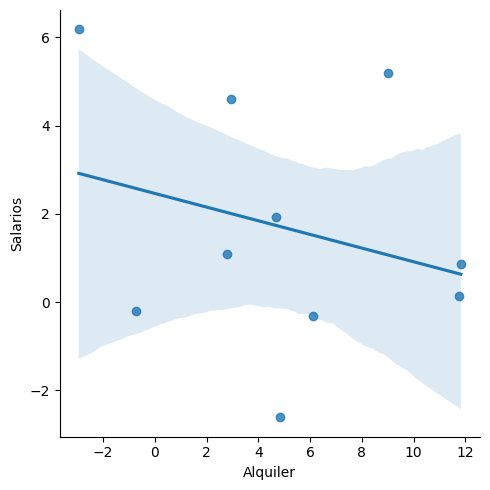

In [15]:
sns.lmplot(salario_ipc_alquiler, x='Alquiler', y='Salarios');

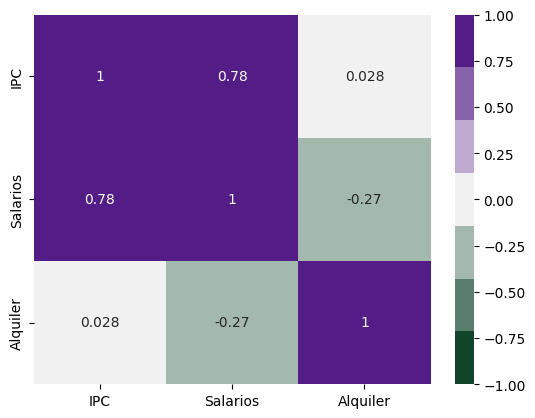

In [16]:
sns.heatmap(salario_ipc_alquiler.corr(numeric_only=True), vmin=-1, vmax=1, annot=True, cmap=sns.diverging_palette(145, 280, s=85, l=25, n=7));

In [17]:
# import figure factory
import plotly.figure_factory as ff


# scatter matrix
fig = ff.create_scatterplotmatrix(salario_ipc_alquiler,
                                 diag = 'box',
                                #  index = salario_ipc_alquiler['Alquiler'],
                                 colormap = sns.diverging_palette(145, 280, s=85, l=25, n=7),
                                 height = 700,
                                 width = 700)


iplot(fig)

### Hipótesis2
El alquiler de viviendas turísticas incide mucho en los precios

In [18]:
crecimiento_vut = f.vut('crecimiento_vivienda_turistica_españa')
crecimiento_vut.head()

,2020,2021,2022,2023,Var.2022/2023(%)
CIUDADES,,,,,
Madrid,21233,15788,14906,19406,30.2
Barcelona,23446,15211,13001,14531,11.8
Valencia,7946,6206,5885,7609,29.3
Málaga,6986,5749,6008,7545,23.9
Sevilla,7679,5899,6002,7247,20.3


In [19]:
# crecimiento_vut['Var.2021/2022(%)'] = round((((crecimiento_vut['2022'] / crecimiento_vut['2021'])-1)*100),1)
# crecimiento_vut['Var.2020/2021(%)'] = round((((crecimiento_vut['2021'] / crecimiento_vut['2020'])-1)*100),1)
# crecimiento_vut

(0.0, 60.0)

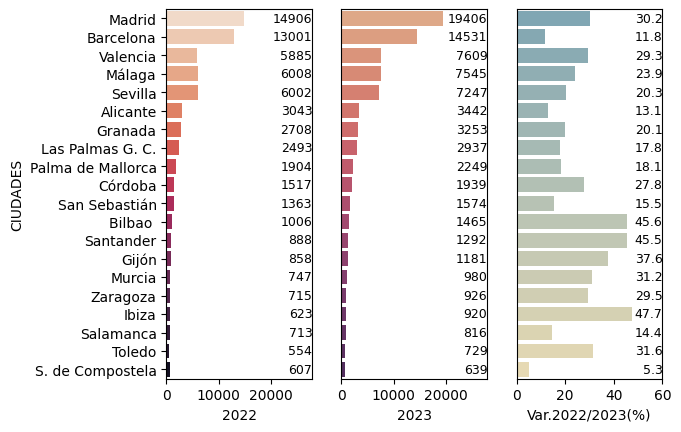

In [20]:

plt.subplot(1, 3, 1) 
sns.barplot(x = crecimiento_vut.iloc[0:20,:]['2022'], y = crecimiento_vut.iloc[0:20,:].index, palette="rocket_r")
for i, value in enumerate(crecimiento_vut.iloc[0:20,:]['2022']):
    plt.text(28000,i,value,fontsize=9,ha='right',va='center')
plt.xlim(0, 28000) 


plt.subplot(1, 3, 2) 
sns.barplot(x = crecimiento_vut.iloc[0:20,:]['2023'], y = crecimiento_vut.iloc[0:20,:].index, palette="flare")
for i, value in enumerate(crecimiento_vut.iloc[0:20,:]['2023']):
    plt.text(28000,i,value,fontsize=9,ha='right',va='center')
plt.yticks([]) 
plt.ylabel('')
plt.xlim(0, 28000) 


plt.subplot(1, 3, 3) 
sns.barplot(x = crecimiento_vut.iloc[0:20,:]['Var.2022/2023(%)'], y = crecimiento_vut.iloc[0:20,:].index, palette="blend:#7AB,#EDA")
for i, value in enumerate(crecimiento_vut.iloc[0:20,:]['Var.2022/2023(%)']):
    plt.text(60,i,value,fontsize=9,ha='right',va='center')
plt.yticks([]) 
plt.ylabel('')
plt.xlim(0, 60) 


In [21]:
ipap = f.ipap('Índice de Precios de Apartamentos Turísticos, Total apartamentos, Tipo de dato')
ipap

,Índice,Tasa de variación interanual
Periodo,,
2014M01,104.43,-0.43
2014M02,108.51,1.27
2014M03,104.48,0.93
2014M04,110.64,4.92
2014M05,112.48,3.77
...,...,...
2023M08,196.86,4.62
2023M09,169.40,8.40
2023M10,155.84,8.41


In [22]:
alq_mad = f.alq_madrid('histórico_alquiler_madrid')
alq_mad


,Precio m2,Variación mensual,Variación trimestral,Variación anual
Mes,,,,
ene-14,11.1,0.2,-1.2,-2.3
feb-14,11.2,0.5,0.0,-1.6
mar-14,11.2,0.0,0.7,-1.0
abr-14,11.2,0.2,0.7,-0.6
may-14,11.2,0.2,0.4,0.3
...,...,...,...,...
ago-23,17.4,2.1,5.0,10.9
sep-23,17.7,1.3,5.1,10.7
oct-23,17.8,0.8,4.2,11.6


In [23]:
ipap.index = alq_mad.index
ipap

,Índice,Tasa de variación interanual
Mes,,
ene-14,104.43,-0.43
feb-14,108.51,1.27
mar-14,104.48,0.93
abr-14,110.64,4.92
may-14,112.48,3.77
...,...,...
ago-23,196.86,4.62
sep-23,169.40,8.40
oct-23,155.84,8.41


In [41]:
alq_ipap = pd.concat([alq_mad,ipap], axis=1)
alq_ipap= alq_ipap.rename(columns={'Precio m2':'alquiler €/m2',
                                   'Variación mensual':'alquiler_var_mensual',
                                   'Variación anual':'alquiler_var_anual',
                                   'Índice':'vut_índice',
                                   'Tasa de variación interanual':'vut_var_anual'})
alq_ipap = alq_ipap.drop(columns='Variación trimestral')
alq_ipap

,alquiler €/m2,alquiler_var_mensual,alquiler_var_anual,vut_índice,vut_var_anual
Mes,,,,,
ene-14,11.1,0.2,-2.3,104.43,-0.43
feb-14,11.2,0.5,-1.6,108.51,1.27
mar-14,11.2,0.0,-1.0,104.48,0.93
abr-14,11.2,0.2,-0.6,110.64,4.92
may-14,11.2,0.2,0.3,112.48,3.77
...,...,...,...,...,...
ago-23,17.4,2.1,10.9,196.86,4.62
sep-23,17.7,1.3,10.7,169.40,8.40
oct-23,17.8,0.8,11.6,155.84,8.41


In [42]:
alq_ipap.corr()

,alquiler €/m2,alquiler_var_mensual,alquiler_var_anual,vut_índice,vut_var_anual
alquiler €/m2,1.000000,0.046730,0.247236,0.629440,-0.015300
alquiler_var_mensual,0.046730,1.000000,0.479293,0.335785,0.487541
alquiler_var_anual,0.247236,0.479293,1.000000,0.267118,0.350836
vut_índice,0.629440,0.335785,0.267118,1.000000,0.340298
vut_var_anual,-0.015300,0.487541,0.350836,0.340298,1.000000


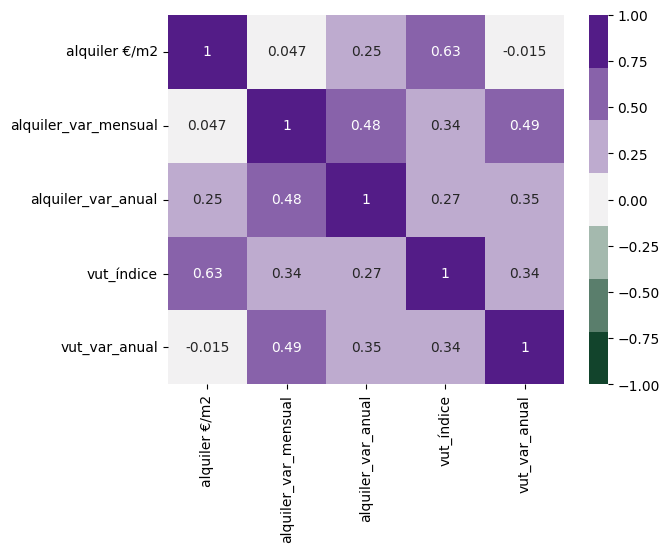

In [37]:
sns.heatmap(alq_ipap.corr(), vmin=-1, vmax=1, annot=True, cmap=sns.diverging_palette(145, 280, s=85, l=25, n=7));

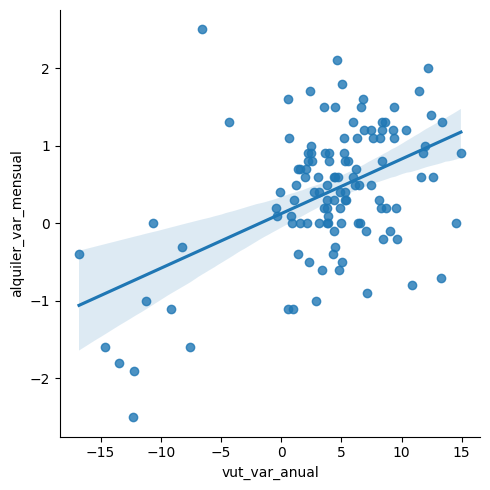

In [43]:
sns.lmplot(alq_ipap, x='vut_var_anual', y='alquiler_var_mensual');

In [44]:
alq_ipap.head()

,alquiler €/m2,alquiler_var_mensual,alquiler_var_anual,vut_índice,vut_var_anual
Mes,,,,,
ene-14,11.1,0.2,-2.3,104.43,-0.43
feb-14,11.2,0.5,-1.6,108.51,1.27
mar-14,11.2,0.0,-1.0,104.48,0.93
abr-14,11.2,0.2,-0.6,110.64,4.92
may-14,11.2,0.2,0.3,112.48,3.77


In [45]:
trace1 = go.Scatter(
                    x = alq_ipap.index,
                    y = alq_ipap['alquiler €/m2'],
                    name = 'alquiler €/m2',
                    mode= 'lines',
                    marker = dict(color = '#df0c7e'),
                    text = 'alquiler €/m2')

trace2 = go.Scatter(
                    x = alq_ipap.index,
                    y = alq_ipap['alquiler_var_mensual'],
                    name = 'Variación anual alquiler (%)',
                    mode= 'lines',
                    marker = dict(color = ' #860a88 '),
                    text = 'Variación anual alquiler (%)')

trace3 = go.Scatter(
                    x = alq_ipap.index,
                    y = alq_ipap['vut_índice'],
                    name = 'Índice precio VUT',
                    mode= 'lines',
                    marker = dict(color = ' #0c6bdf '),
                    text = 'precio VUT')

trace4 = go.Scatter(
                    x = alq_ipap.index,
                    y = alq_ipap['vut_var_anual'],
                    name = 'Variación anual índice VUT (%)',
                    mode= 'lines',
                    marker = dict(color = ' #0a6a88 '),
                    text = 'Variación anual índice VUT (%)')

data = [trace1, trace2, trace3, trace4]

layout = dict(title = 'Jóvenes de 16 a 29 años en la EPA (Edad de Población Activa)',
             xaxis= dict(title= 'Años',ticklen= 5)
           )

fig = go.Figure(data = data, layout=layout)

iplot(fig)

In [96]:
airbnb = pd.read_csv('./data/listings_insideairbnb_mad_dic23.csv')
airbnb


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365,number_of_reviews_ltm,license
0,6369,Rental unit in Madrid · ★4.88 · 1 bedroom · 1 ...,13660,Simon,Chamartín,Hispanoamérica,40.457240,-3.676880,Private room,85.0,5,106,2023-10-16,0.63,1,22,4,NaN
1,30320,Rental unit in Madrid · ★4.63 · 1 bedroom · 2 ...,130907,Dana,Centro,Sol,40.414760,-3.704180,Entire home/apt,65.0,5,172,2022-09-26,1.05,3,0,0,NaN
2,21853,Rental unit in Madrid · ★4.58 · 1 bedroom · 1 ...,83531,Abdel,Latina,Cármenes,40.403810,-3.741300,Private room,31.0,4,33,2018-07-15,0.30,2,135,0,NaN
3,24805,Rental unit in Madrid · ★4.91 · 6 bedrooms · 1...,346366726,Alvaro,Centro,Universidad,40.421830,-3.705290,Entire home/apt,94.0,5,33,2023-11-06,0.30,1,168,8,NaN
4,30959,Loft in Madrid · ★4.38 · 1 bedroom · 1 bed · 1...,132883,Angela,Centro,Embajadores,40.412590,-3.701050,Entire home/apt,NaN,3,8,2017-05-30,0.08,1,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
25538,1046219783290634155,Rental unit in Madrid · ★New · 2 bedrooms · 3 ...,529402573,Sara,Usera,Zofío,40.384658,-3.714106,Entire home/apt,120.0,1,0,NaN,NaN,56,303,0,NaN
25539,1045519419976898566,Rental unit in Madrid · ★New · 1 bedroom · 1 b...,529402573,Sara,Salamanca,Guindalera,40.438832,-3.671323,Entire home/apt,120.0,1,0,NaN,NaN,56,189,0,NaN
25540,1046222300986271054,Rental unit in Madrid · ★New · 1 bedroom · 1 b...,31772865,CituSpace,Tetuán,Castillejos,40.458234,-3.695566,Entire home/apt,171.0,1,0,NaN,NaN,42,318,0,NaN
25541,1046239141714406672,Rental unit in Madrid · ★New · 2 bedrooms · 4 ...,346367515,Ukio,Chamberí,Arapiles,40.433040,-3.711060,Entire home/apt,74.0,31,0,NaN,NaN,237,326,0,NaN


In [97]:
airbnb = airbnb[['latitude','longitude']]
airbnb

,latitude,longitude
0,40.457240,-3.676880
1,40.414760,-3.704180
2,40.403810,-3.741300
3,40.421830,-3.705290
4,40.412590,-3.701050
...,...,...
25538,40.384658,-3.714106
25539,40.438832,-3.671323
25540,40.458234,-3.695566
25541,40.433040,-3.711060


In [99]:
dict_airbnb = {}

for i in range(len(airbnb)):
    dict_airbnb[i] = [airbnb.iloc[i,0], airbnb.iloc[i,1]]
dict_airbnb

{0: [40.45724, -3.67688],
 1: [40.41476, -3.70418],
 2: [40.40381, -3.7413],
 3: [40.42183, -3.70529],
 4: [40.41259, -3.70105],
 5: [40.38975, -3.69018],
 6: [40.42242, -3.69562],
 7: [40.41969, -3.69736],
 8: [40.42247, -3.70577],
 9: [40.42838, -3.70345],
 10: [40.41285, -3.69553],
 11: [40.41037, -3.70018],
 12: [40.41884, -3.69655],
 13: [40.41015, -3.69797],
 14: [40.47148, -3.68946],
 15: [40.42881, -3.66605],
 16: [40.4249, -3.7097],
 17: [40.40988, -3.67503],
 18: [40.41676, -3.70682],
 19: [40.42252, -3.7025],
 20: [40.41944, -3.70945],
 21: [40.42166, -3.69615],
 22: [40.40334, -3.70254],
 23: [40.41115, -3.69673],
 24: [40.41959, -3.70373],
 25: [40.41506, -3.7029],
 26: [40.42252, -3.7025],
 27: [40.42771, -3.71029],
 28: [40.4149, -3.70331],
 29: [40.42552, -3.70589],
 30: [40.42978, -3.67817],
 31: [40.41281, -3.70749],
 32: [40.40864, -3.70884],
 33: [40.40827, -3.70049],
 34: [40.42342, -3.68123],
 35: [40.42738, -3.70635],
 36: [40.41155, -3.70146],
 37: [40.43028, -3

In [100]:
import folium # pip install folium
from folium import plugins
# import ipywidgets # pip install ipywidgets
import geocoder # pip install geocoder
# import geopy # pip install geopy
import numpy as np
import pandas as pd
from vega_datasets import data as vds # pip install vega_datasets

In [101]:
# multiple markers using dictionary
dict_airbnb

# create map
map_cities = folium.Map(location=[40.4165, -3.70256], zoom_start=10)

# plot locations
for i in dict_airbnb.items():
    folium.Marker(location=i[1], popup=i[0]).add_to(map_cities)
    print(i)

# display map    
map_cities

(0, [40.45724, -3.67688])
(1, [40.41476, -3.70418])
(2, [40.40381, -3.7413])
(3, [40.42183, -3.70529])
(4, [40.41259, -3.70105])
(5, [40.38975, -3.69018])
(6, [40.42242, -3.69562])
(7, [40.41969, -3.69736])
(8, [40.42247, -3.70577])
(9, [40.42838, -3.70345])
(10, [40.41285, -3.69553])
(11, [40.41037, -3.70018])
(12, [40.41884, -3.69655])
(13, [40.41015, -3.69797])
(14, [40.47148, -3.68946])
(15, [40.42881, -3.66605])
(16, [40.4249, -3.7097])
(17, [40.40988, -3.67503])
(18, [40.41676, -3.70682])
(19, [40.42252, -3.7025])
(20, [40.41944, -3.70945])
(21, [40.42166, -3.69615])
(22, [40.40334, -3.70254])
(23, [40.41115, -3.69673])
(24, [40.41959, -3.70373])
(25, [40.41506, -3.7029])
(26, [40.42252, -3.7025])
(27, [40.42771, -3.71029])
(28, [40.4149, -3.70331])
(29, [40.42552, -3.70589])
(30, [40.42978, -3.67817])
(31, [40.41281, -3.70749])
(32, [40.40864, -3.70884])
(33, [40.40827, -3.70049])
(34, [40.42342, -3.68123])
(35, [40.42738, -3.70635])
(36, [40.41155, -3.70146])
(37, [40.43028, -3